### Understanding The accuracy of images generated from pdf files to ensure the extracted informatio is accurate! 

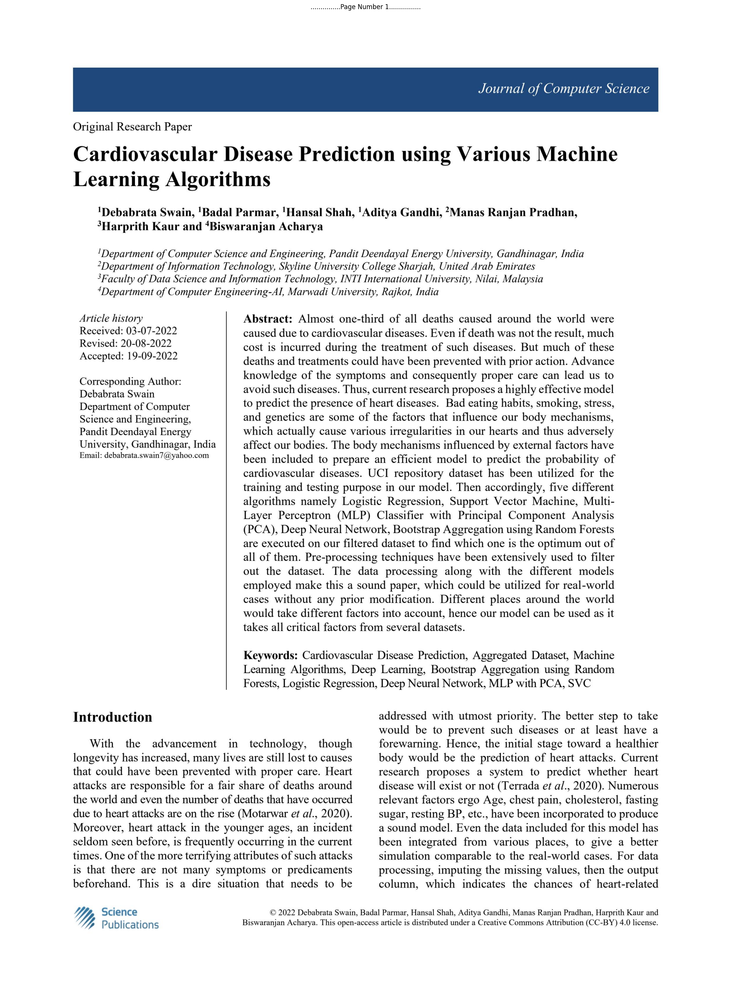

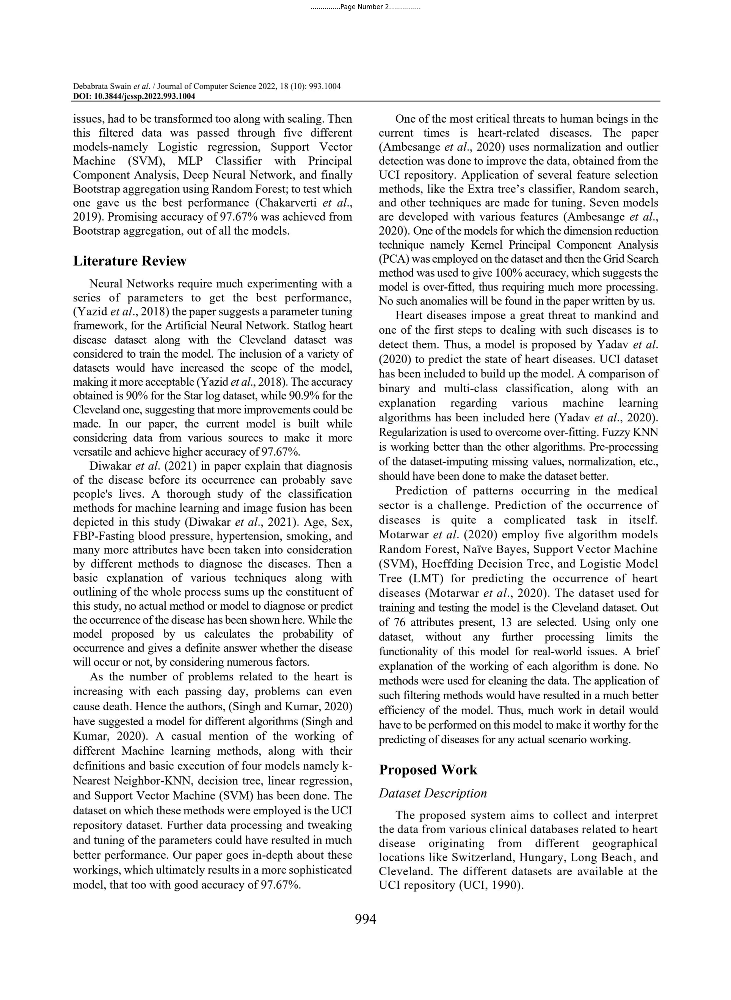

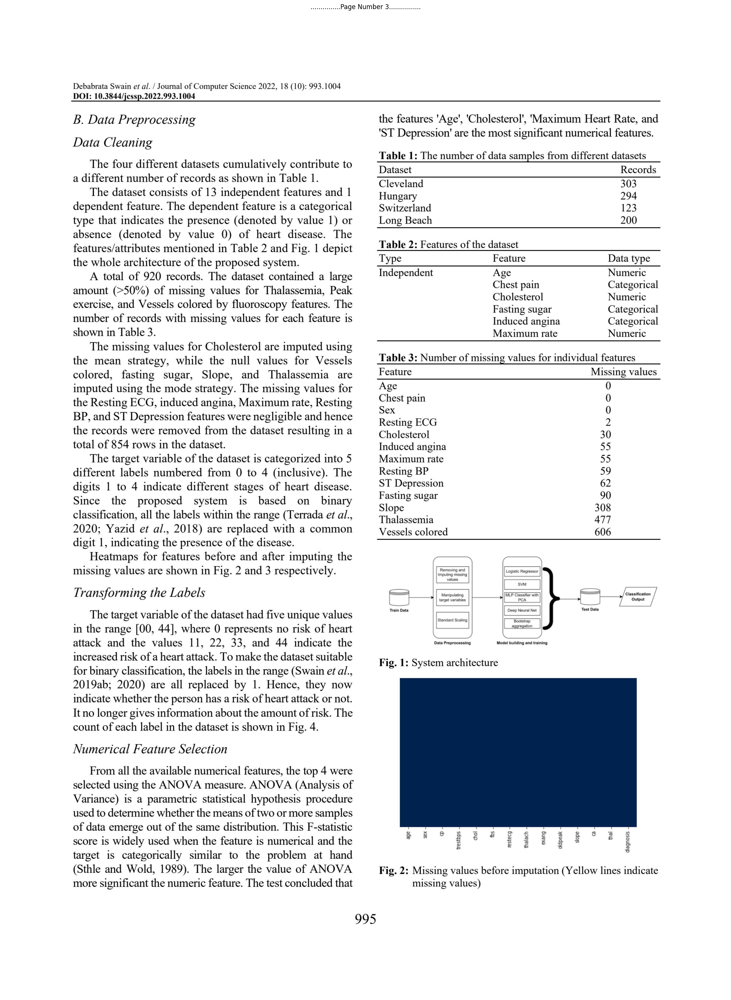

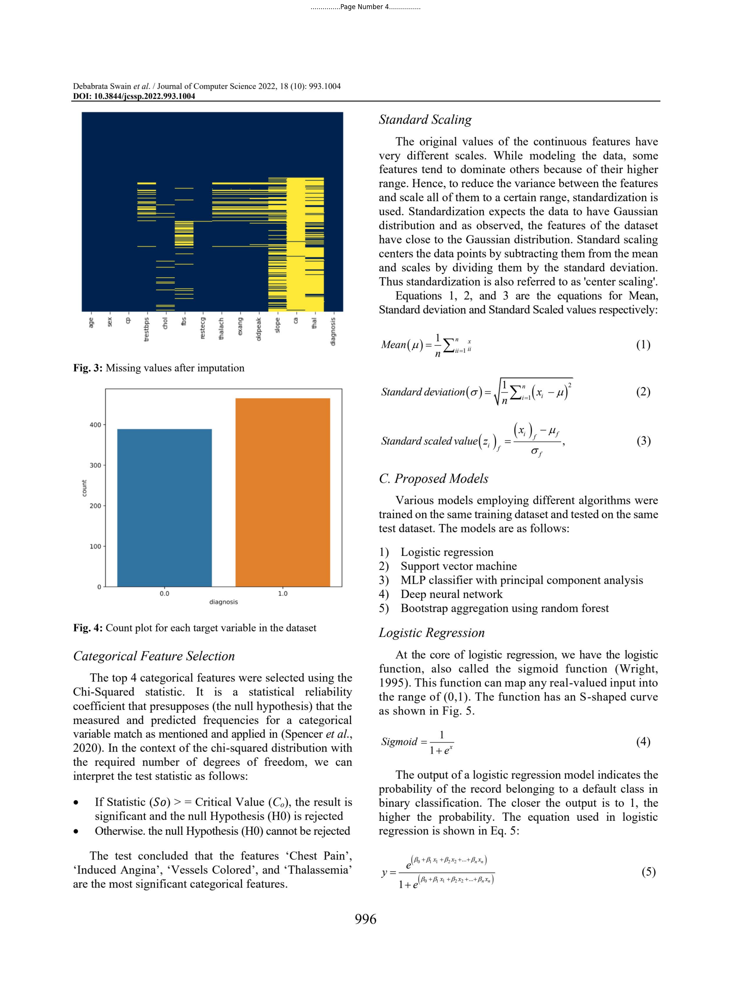

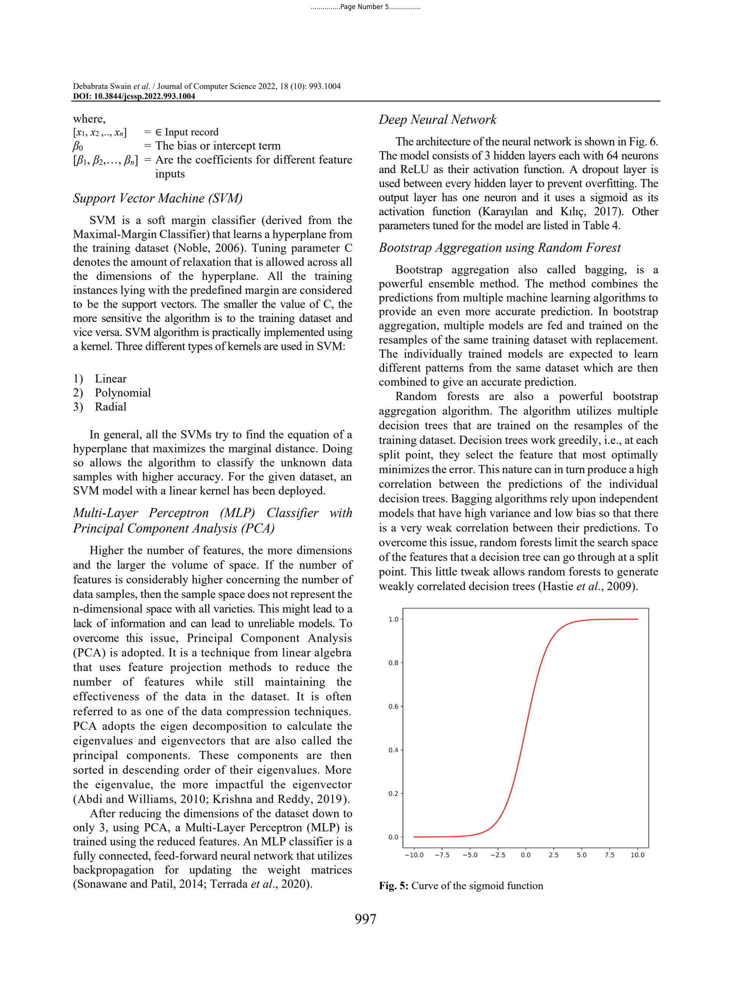

...

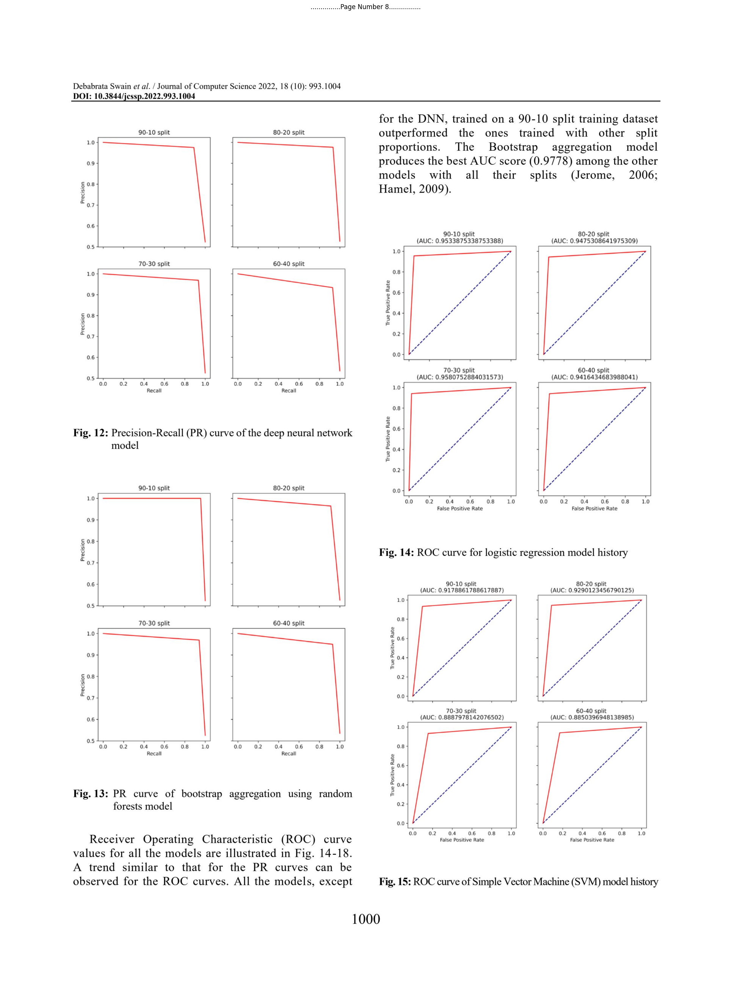

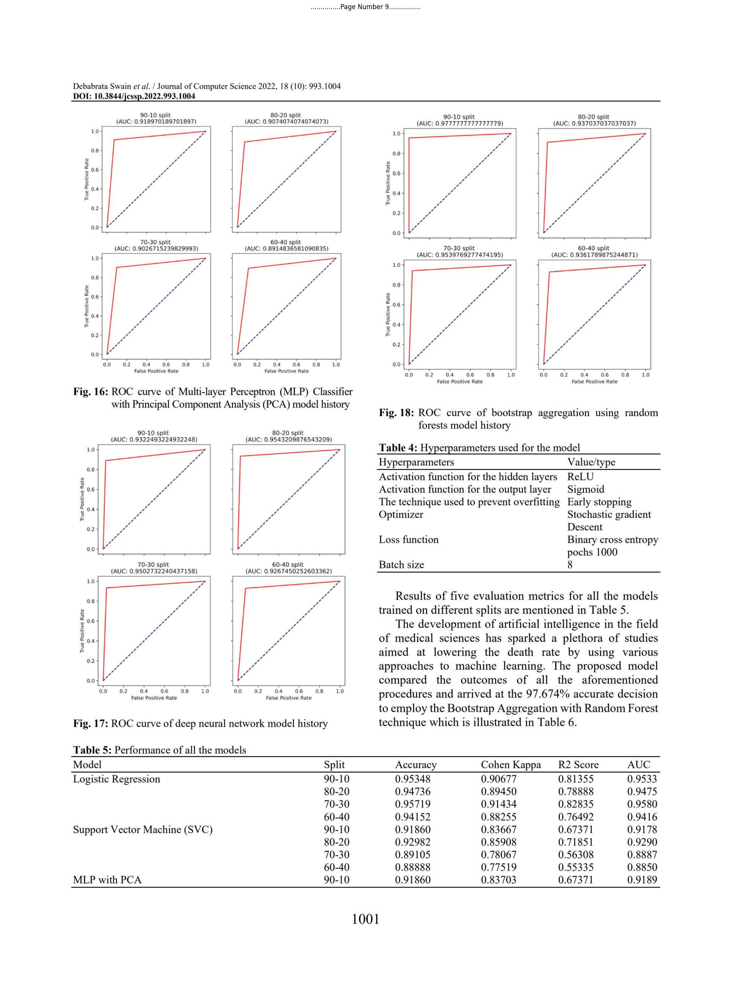

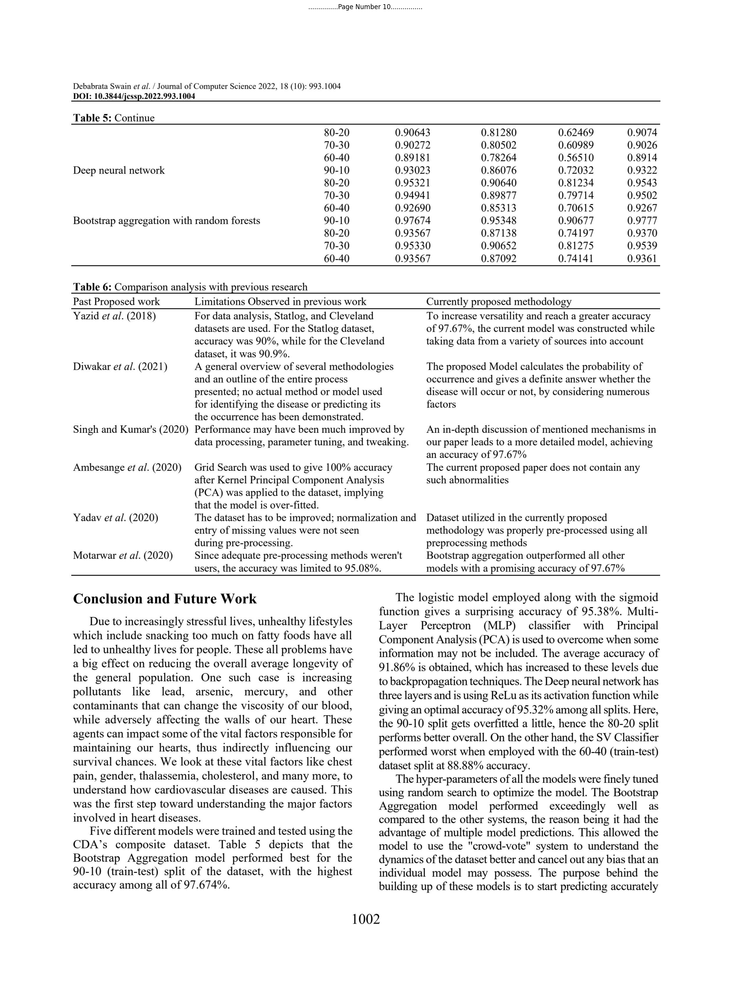

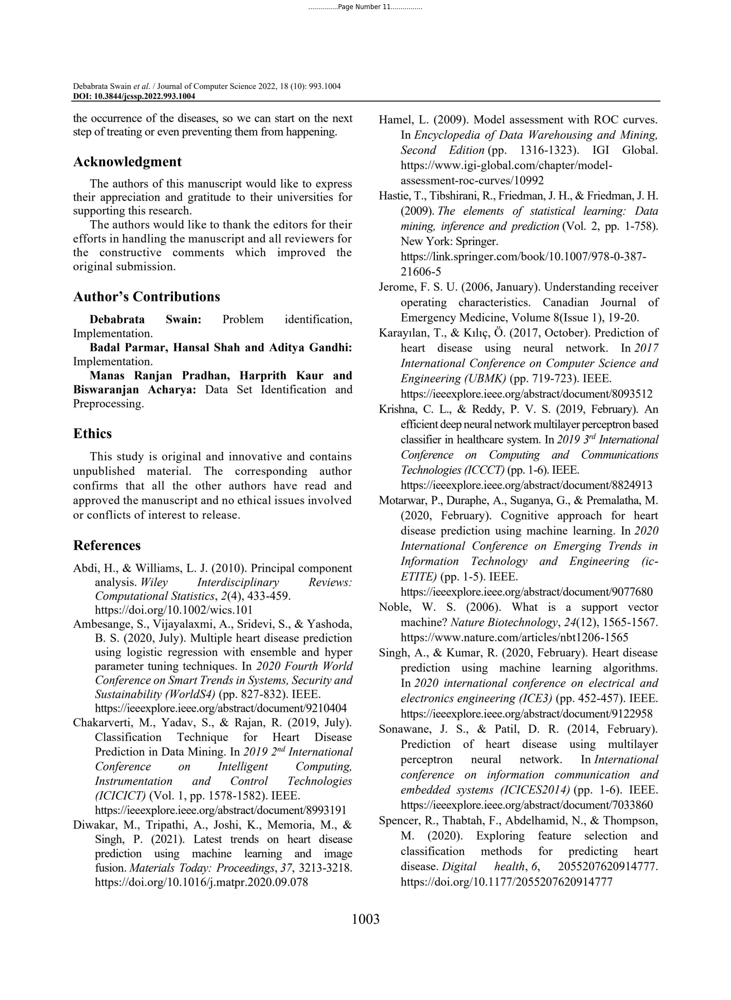

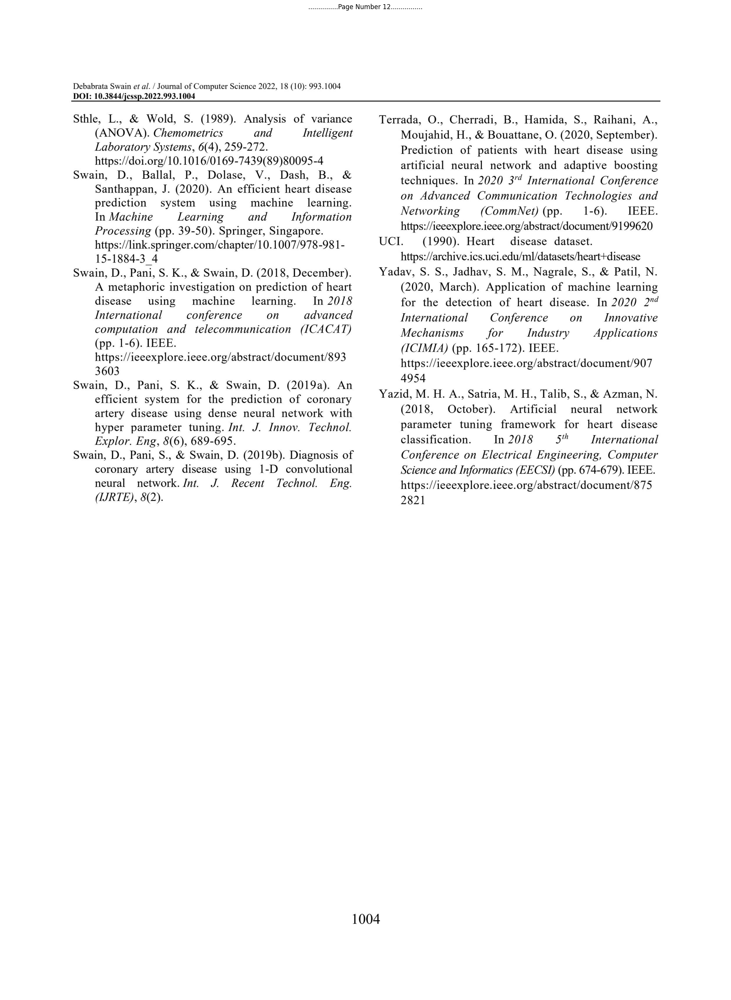

In [1]:
import pypdfium2 as pdfium
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

def convert_pdf_to_images(file_path, scale=300/72):
    pdf_file = pdfium.PdfDocument(file_path)
    page_indices = [i for i in range(len(pdf_file))]

    renderer = pdf_file.render(
        pdfium.PdfBitmap.to_pil,
        page_indices=page_indices,
        scale=scale,
    )

    list_final_images = []
    for i, image in zip(page_indices, renderer):
        image_byte_array = BytesIO()
        image.save(image_byte_array, format='jpeg', optimize=True)
        # Get raw bytes from the BytesIO object
        image_bytes = image_byte_array.getvalue()
        list_final_images.append({i: image_bytes})
    
    return list_final_images

def display_images(list_dict_final_images):
    # Extract the raw bytes from the list of dictionaries
    all_images = [list(data.values())[0] for data in list_dict_final_images]

    for index, image_bytes in enumerate(all_images):
        # Open the image using the raw bytes
        image = Image.open(BytesIO(image_bytes))
        figure = plt.figure(figsize=(image.width / 100, image.height / 100))

        plt.title(f"...............Page Number {index+1}................")
        plt.imshow(image)
        plt.axis("off")
        plt.show()

# Specify the file path of your PDF
pdf_file = r"D:\Masters-AI\Semester 2 subjects\Natural Language Processing\NLP Project\Pdf\Cardiovascular disease detection.pdf"

# Convert PDF to images and display them
converted_images = convert_pdf_to_images(pdf_file)
display_images(converted_images)

### Comparing a few libraries to for text extraction capabilities (Pyterssaract, PyPDF2, Langchain)

### Pytessaract 

In [2]:
import pytesseract
from PIL import Image
from io import BytesIO

# Specify the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"

def extract_text_from_pdf_with_tesseract(list_dict_final_images):
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        image = Image.open(BytesIO(image_bytes))
        raw_text = str(pytesseract.image_to_string(image))
        image_content.append(raw_text)

    return "\n".join(image_content)

# Convert PDF to images
converted_images = convert_pdf_to_images(pdf_file)

# Extract text using Tesseract
text_with_pytesseract = extract_text_from_pdf_with_tesseract(converted_images)

# Print the extracted text
print(text_with_pytesseract)


Journal of Computer Science

Original Research Paper

Cardiovascular Disease Prediction using Various Machine
Learning Algorithms

'Debabrata Swain, !Badal Parmar, 'Hansal Shah, 'Aditya Gandhi, 7Manas Ranjan Pradhan,
3Harprith Kaur and ‘Biswaranjan Acharya

'Department of Computer Science and Engineering, Pandit Deendayal Energy University, Gandhinagar, India
?Department of Information Technology, Skyline University College Sharjah, United Arab Emirates

3Faculty of Data Science and Information Technology, INTI International University, Nilai, Malaysia
4Department of Computer Engineering-AI, Marwadi University, Rajkot, India

Article history
Received: 03-07-2022
Revised: 20-08-2022
Accepted: 19-09-2022

Corresponding Author:
Debabrata Swain

Department of Computer
Science and Engineering,
Pandit Deendayal Energy
University, Gandhinagar, India

Email: debabrata.swain7@yahoo.com

Abstract: Almost one-third of all deaths caused around the world were
caused due to cardiovascular diseases. 

### 1.2 Pypdf2

In [3]:
from PyPDF2 import PdfReader

def extract_text_with_pypdf(PDF_file):
    pdf_reader = PdfReader(PDF_file)

    raw_text = ' '

    for i, page in enumerate(pdf_reader.pages):
        text = page.extract_text()
        if text:
            raw_text += text

    return raw_text

PDF_file_path = r"D:\Masters-AI\Semester 2 subjects\Natural Language Processing\NLP Project\Pdf\Cardiovascular disease detection.pdf"
text_pypdf = extract_text_with_pypdf(PDF_file_path)

print(text_pypdf)

  
 
 © 2022 Debabrata Swain, Badal Parmar, Hansal Shah, Aditya Gandhi, Manas Ranjan Pradhan, Harprith Kaur  and 
Biswaranjan Acharya . This open -access article is distributed under a Creative Commons Attribution (CC -BY) 4.0 license.   Journal of Computer Science  
 
 
 
Original Research Paper  
Cardiovascular Disease Prediction using Various Machine 
Learnin g Algorithms  
 
1Debabrata Swain,  1Badal Parmar, 1Hansal Shah, 1Aditya Gandhi, 2Manas Ranjan Pradhan,  
3Harprith Kaur  and 4Biswaranjan Acharya  
 
1Department of Computer Science and Engineering, Pandit Deendayal Energy University, Gandhinagar, India  
2Department of Information Technology, Skyline University College Sharjah, United Arab Emirates  
3Faculty of Data Science and Information Technology, INTI International University, Nilai, Malaysia  
4Department of Computer Engineering -AI, Marwadi University, Rajkot, India  
 
Article history  
Received: 03-07-2022  
Revised: 20-08-2022  
Accepted: 19-09-2022  
 
Correspondi

**Conclusion**  :  *As per our experiments we found Pytersseract to be more accurate compared to other text extraction libraries, also it is challenging without tools like "GROBID"  in comparision with "GROBID";  Pytessaract does well to extract the information sometimes the formatting could be an issue however in main logic we have tried to define some structures to understand the logics based on the provided input pdf file*

### Implementing Main Logic 

In [ ]:
import os
import re
import json
from io import BytesIO

import pypdfium2 as pdfium
import pytesseract
from PIL import Image

import fitz          # PyMuPDF for image extraction
import camelot       # For table extraction


# Specify the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"



######################################################################################################################################################################################
# 0) Custom based on Two columns or single columns (however restricted to the fact if the dataset is consistent, we tried various formats so we tried not to depend on this technique)
#######################################################################################################################################################################################


# Tesseract page segmentation mode (common choices: 4, 6, 11, etc.)
# TESSERACT_PSM = 4

# If lines are under this length and don't end in punctuation, merge them with the next line
# MERGE_LINE_CHAR_THRESHOLD = 50

###############################################################################
# 1) PDF -> Images with pypdfium2
###############################################################################
def convert_pdf_to_images(pdf_path, dpi=300):
    """
    Uses pypdfium2 to render each page as a PIL Image in memory (JPEG bytes).
    Returns a list of dicts [{page_index: image_bytes}, ...].
    """
    scale = dpi / 72.0
    pdf_doc = pdfium.PdfDocument(pdf_path)
    page_indices = list(range(len(pdf_doc)))

    renderer = pdf_doc.render(
        pdfium.PdfBitmap.to_pil,
        page_indices=page_indices,
        scale=scale,
    )

    images_list = []
    for idx, pil_image in zip(page_indices, renderer):
        buf = BytesIO()
        pil_image.save(buf, format='JPEG', optimize=True)
        image_bytes = buf.getvalue()
        images_list.append({idx: image_bytes})
    return images_list


###############################################################################
# 2) Tesseract OCR for Each Page Image
###############################################################################
def extract_text_from_pdf_with_tesseract(list_of_image_dicts):
    """
    list_of_image_dicts: e.g. [{0: b'...'}, {1: b'...'}, ...]
    Returns a list of text strings, one per page (same order).
    """
    page_texts = []
    # Sort by page index just to be sure
    sorted_image_dicts = sorted(list_of_image_dicts, key=lambda d: list(d.keys())[0])

    for image_dict in sorted_image_dicts:
        (page_idx, img_bytes), = image_dict.items()
        img = Image.open(BytesIO(img_bytes))

        # Basic Tesseract call
        raw_text = pytesseract.image_to_string(img)
        page_texts.append(raw_text)
    return page_texts


###############################################################################
# 3) Simple "Boldest Line" = "Title" Heuristic
###############################################################################
def find_first_bold_line(lines, min_len=10):
    """
    We approximate 'bold line' by the first line that is mostly uppercase or
    obviously bigger than min_len. Adjust logic as needed.
    """
    best_line = "Unknown Title"
    for line in lines:
        # skip lines too short
        if len(line) < min_len:
            continue
        # if line is uppercase or has a high uppercase ratio
        uppercase_ratio = sum(ch.isupper() for ch in line) / (len(line) + 1)
        if uppercase_ratio > 0.5:
            return line.strip()
        # else pick the first decently long line
        return line.strip()
    return best_line


###############################################################################
# 4) Simple Structuring of the OCR Text => JSON
###############################################################################
def structure_text_into_json(page_texts):
    """
    Basic approach: 
      - The "most bold line" from the first page is the main heading.
      - The rest becomes 'paragraphs'.
    Returns a dict with {title: ..., content: [ ... ]}.
    """
    if not page_texts:
        return {"title": "Unknown Title", "content": []}

    first_page_lines = [l.strip() for l in page_texts[0].split("\n") if l.strip()]
    # Our "title" is the first "bold" or longer line in the first page
    main_title = find_first_bold_line(first_page_lines)

    # Combine everything as paragraphs
    all_paragraphs = []
    for page_idx, text in enumerate(page_texts):
        lines = [l.strip() for l in text.split("\n") if l.strip()]
        # skip the line that was used as a title if it's exactly the same
        lines = [ln for ln in lines if ln != main_title]
        all_paragraphs.extend(lines)

    data = {
        "title": main_title,
        "content": all_paragraphs
    }
    return data


###############################################################################
# 5) Table Extraction (Camelot)
###############################################################################
def extract_tables(pdf_path, output_dir="tables_output"):
    """
    Use Camelot (both 'lattice' and 'stream') to extract tables.
    Saves each table as CSV in output_dir, returns a list of table references.
    """
    if not os.path.exists(output_dir):
        os.makedirs(output_dir, exist_ok=True)

    tables_info = []
    # 1) Lattice
    try:
        tables_lattice = camelot.read_pdf(pdf_path, pages="all", flavor="lattice")
        for i, tbl in enumerate(tables_lattice):
            csv_path = os.path.join(output_dir, f"table_page{tbl.page}_lattice_{i+1}.csv")
            tbl.df.to_csv(csv_path, index=False)
            tables_info.append({"page": tbl.page, "csv_path": csv_path, "flavor": "lattice"})
    except Exception as e:
        print(f"[Warning] Lattice table extraction failed: {e}")

    # 2) Stream
    try:
        tables_stream = camelot.read_pdf(pdf_path, pages="all", flavor="stream")
        for i, tbl in enumerate(tables_stream):
            csv_path = os.path.join(output_dir, f"table_page{tbl.page}_stream_{i+1}.csv")
            tbl.df.to_csv(csv_path, index=False)
            tables_info.append({"page": tbl.page, "csv_path": csv_path, "flavor": "stream"})
    except Exception as e:
        print(f"[Warning] Stream table extraction failed: {e}")

    return tables_info


###############################################################################
# 6) Image Extraction (PyMuPDF)
###############################################################################
def extract_images(pdf_path, output_dir="images_output"):
    """
    Extract embedded images using PyMuPDF. Save them to output_dir. 
    Return a list of {page, file} references.
    """
    if not os.path.exists(output_dir):
        os.makedirs(output_dir, exist_ok=True)

    doc = fitz.open(pdf_path)
    images_info = []
    for page_idx in range(len(doc)):
        page = doc[page_idx]
        img_list = page.get_images(full=True)
        for img_index, img in enumerate(img_list):
            xref = img[0]
            base_image = doc.extract_image(xref)
            ext = base_image["ext"]
            data = base_image["image"]
            out_fn = f"page{page_idx+1}_img{img_index+1}.{ext}"
            out_path = os.path.join(output_dir, out_fn)
            with open(out_path, "wb") as f:
                f.write(data)
            images_info.append({"page": page_idx+1, "file": out_path})
    return images_info


###############################################################################
# MAIN PIPELINE
###############################################################################
def parse_pdf_with_pypdfium_tesseract_tables_images(pdf_path, output_json="final_output.json"):
    """
    1) Convert PDF to images with pypdfium2
    2) OCR them with Tesseract
    3) Build a simple structure from the text
    4) Extract tables with Camelot
    5) Extract embedded images with PyMuPDF
    6) Save JSON
    """
    # Step 1) PDF -> Images
    list_of_img_dicts = convert_pdf_to_images(pdf_path, dpi=300)

    # Step 2) Tesseract OCR
    all_page_texts = extract_text_from_pdf_with_tesseract(list_of_img_dicts)

    # Step 3) Simple structuring => { "title": ..., "content": [...] }
    text_data = structure_text_into_json(all_page_texts)

    # Step 4) Table Extraction
    table_data = extract_tables(pdf_path, output_dir="tables_output")

    # Step 5) Image Extraction
    image_data = extract_images(pdf_path, output_dir="images_output")

    # Combine final
    final_json = {
        "title": text_data["title"],
        "pages_ocr": text_data["content"],     # each line is a "paragraph"
        "tables": table_data,                  # references to CSV
        "images": image_data                   # references to saved images
    }

    # Save to JSON
    with open(output_json, "w", encoding="utf-8") as f:
        json.dump(final_json, f, indent=2, ensure_ascii=False)

    print(f"Done. Output => {output_json}")
    print(f"Extracted {len(table_data)} tables -> tables_output/")
    print(f"Extracted {len(image_data)} images -> images_output/")

    return final_json


###############################################################################
# USAGE EXAMPLE
###############################################################################
if __name__ == "__main__":
    # Make sure you have installed the libraries:
    # pip install pypdfium2 pytesseract Pillow fitz camelot-py ghostscript
    #
    # And Tesseract is installed on your system
    #
    pdf_file = r"D:\Masters-AI\Semester 2 subjects\Natural Language Processing\NLP Project\Pdf\Cardiovascular disease detection.pdf"
    parse_pdf_with_pypdfium_tesseract_tables_images(pdf_file, output_json="final_output.json")

c:\Users\Pranj\AppData\Local\Programs\Python\Python310\lib\site-packages\camelot\parsers\base.py:238: UserWarning: No tables found in table area (67.064, 563.436, 489.47, 699.1057221052632)
  cols, rows, v_s, h_s = self._generate_columns_and_rows(bbox, user_cols)


Done. Output => final_output.json
Extracted 20 tables -> tables_output/
Extracted 20 images -> images_output/
